# Symulowane wyżarzanie
### Autorzy: Belkius Grzegorz
Aby zaimplementować algorytm wyżarzania (simulated annealing) do rozwiązania problemu komiwojażera (TSP) z wizualizacją i symulacją krokową, użyjemy następujących elementów:

1. Funkcja algorytmu wyżarzania: Ten algorytm działa poprzez stopniowe zmniejszanie "temperatury" systemu, co pozwala na eksplorację przestrzeni rozwiązań i stopniowe przechodzenie do stanów o niższej energii (czyli lepszych rozwiązań).

2. Operatory zmiany trasy:
 - Zamiana dwóch miast miejscami (swap).
 - Odwrócenie kolejności miast między dwoma pozycjami (reverse).
 - Przesunięcie jednego miasta w inne miejsce (insert).
 - Zamiana dwóch odcinków między czterema miastami (4-opt).

3. Dane z Biblioteka TSPlib: dane zawierają zestawy problemów komiwojażera, wykorzystamy 5 zestawów:
 - pr439
 - rl1323
 - fl1400
 - d657
 - dsj1000

 Dane dostępne pod linkiem (08.06.2024 r.) - http://comopt.ifi.uni-heidelberg.de/software/TSPLIB95/tsp/

4. Wizualizacja: Pokażemy kroki symulacji, aby zobaczyć, jak algorytm działa przy pomocy biblioteki pyplot.

## Pseudokod
Funkcja read_tsplib
1. Otwórz plik z danymi TSPlib.
2. Zainicjuj listę coords do przechowywania współrzędnych.
3. Ustaw reading_nodes na False.
4. Dla każdej linii w pliku:
 - Jeśli linia zaczyna się od "NODE_COORD_SECTION", ustaw reading_nodes na True.
 - Jeśli linia zaczyna się od "EOF", przerwij pętlę.
 - Jeśli reading_nodes jest True, podziel linię na części i dodaj współrzędne do coords.
5. Zwróć listę coords.

Funkcja distance
1. Oblicz i zwróć odległość euklidesową między punktami p1 i p2.

Funkcja total_distance
1. Zainicjuj zmienną total jako 0.
2. Dla każdego miasta i w trasie tour:
 - Dodaj odległość między miastem i a miastem (i + 1) % len(tour) do total.
3. Zwróć total.

Operatory zmiany trasy (swap, reverse, insert, four_opt)
1. swap:
 - Skopiuj bieżącą trasę.
 - Wybierz dwa losowe indeksy i i j.
 - Zamień miasta na indeksach i i j.
 - Zwróć nową trasę.

2. reverse:
 - Skopiuj bieżącą trasę.
 - Wybierz dwa losowe indeksy i i j i posortuj je.
 - Odwróć kolejność miast między indeksami i a j.
 - Zwróć nową trasę.

3. insert:
 - Skopiuj bieżącą trasę.
 - Wybierz dwa losowe indeksy i i j.
 - Usuń miasto na indeksie i i wstaw je na indeks j.
 - Zwróć nową trasę.

4. four_opt:
 - Skopiuj bieżącą trasę.
 - Wybierz dwa losowe indeksy i i j i posortuj je.
 - Jeśli j + 1 jest mniejsze niż długość trasy, odwróć kolejność miast między indeksami i a j.
 - Zwróć nową trasę.

Algorytm simulated_annealing
1. Ustaw current_tour jako lista miast w kolejności rosnącej.
2. Oblicz current_distance jako całkowitą odległość current_tour.
3. Ustaw best_tour jako current_tour.
4. Ustaw best_distance jako current_distance.
5. Ustaw temperature jako initial_temperature.
6. Inicjalizuj listę distances.
7. Dla iteration od 0 do num_iterations:
 - Jeśli temperature jest mniejsza lub równa 0, przerwij pętlę.
 - Wybierz losowy operator zmiany trasy.
 - Zastosuj operator do current_tour, tworząc new_tour.
 - Oblicz new_distance dla new_tour.
 - Jeśli new_distance jest mniejsze niż current_distance lub losowa liczba jest mniejsza niż exp((current_distance - new_distance) / temperature):
    - Ustaw current_tour na new_tour.
    - Ustaw current_distance na new_distance.
    - Jeśli new_distance jest mniejsze niż best_distance:
      - Ustaw best_tour na new_tour.
      - Ustaw best_distance na new_distance.
 - Dodaj best_distance do distances.
 - Zmniejsz temperature przez przemnożenie przez cooling_rate.
 - Co 100 iteracji, wywołaj plot_tour z coords, best_tour, iteration i best_distance.
8. Zwróć best_tour, best_distance i distances.

Funkcja plot_tour
1. Stwórz nowy wykres.
2. Narysuj miasta jako czerwone punkty.
3. Narysuj trasę jako niebieską linię.
4. Ustaw tytuł wykresu jako Iteration {iteration}, Distance: {distance}.
5. Pokaż wykres.

In [ ]:
# @title Wczytanie bibliotek oraz danych z dysku
import matplotlib.pyplot as plt
import numpy as np
import random

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# @title Zdefiniowanie funkcji oraz stałych
initial_temperature = 1000
cooling_rate = 0.995
num_iterations = 100000


def read_tsplib(filename):
    with open(filename, 'r') as f:
        lines = f.readlines()

    coords = []
    reading_nodes = False
    for line in lines:
        if line.startswith("NODE_COORD_SECTION"):
            reading_nodes = True
            continue
        if line.startswith("EOF"):
            break
        if reading_nodes:
            parts = line.strip().split()
            coords.append((float(parts[1]), float(parts[2])))

    return coords


def distance(p1, p2):
    return np.sqrt((p1[0] - p2[0]) ** 2 + (p1[1] - p2[1]) ** 2)


def total_distance(tour, coords):
    return sum(distance(coords[tour[i]], coords[tour[(i + 1) % len(tour)]]) for i in range(len(tour)))


def swap(tour):
    new_tour = tour[:]
    i, j = random.sample(range(len(tour)), 2)
    new_tour[i], new_tour[j] = new_tour[j], new_tour[i]
    return new_tour


def reverse(tour):
    new_tour = tour[:]
    i, j = sorted(random.sample(range(len(tour)), 2))
    new_tour[i:j + 1] = reversed(new_tour[i:j + 1])
    return new_tour


def insert(tour):
    new_tour = tour[:]
    i, j = random.sample(range(len(tour)), 2)
    city = new_tour.pop(i)
    new_tour.insert(j, city)
    return new_tour


def four_opt(tour):
    new_tour = tour[:]
    i, j = sorted(random.sample(range(len(tour)), 2))
    if j + 1 < len(tour):
        new_tour[i:j + 1] = reversed(new_tour[i:j + 1])
    return new_tour


def plot_tour(coords, tour, iteration, distance):
    plt.figure(figsize=(10, 6))
    plt.scatter([x for x, y in coords], [y for x, y in coords], color='red')
    tour_coords = [coords[city] for city in tour] + [coords[tour[0]]]
    plt.plot([x for x, y in tour_coords], [y for x, y in tour_coords], color='blue')
    plt.title(f'Iteration {iteration}, Distance: {distance:.2f}')
    plt.show()


def simulated_annealing(coords, initial_temperature, cooling_rate, num_iterations):
    current_tour = list(range(len(coords)))
    current_distance = total_distance(current_tour, coords)
    best_tour = current_tour[:]
    best_distance = current_distance
    temperature = initial_temperature

    distances = []

    for iteration in range(num_iterations):
        if temperature <= 0:
            break

        operator = random.choice([swap, reverse, insert, four_opt])
        new_tour = operator(current_tour)
        new_distance = total_distance(new_tour, coords)

        if new_distance < current_distance or random.random() < np.exp((current_distance - new_distance) / temperature):
            current_tour = new_tour
            current_distance = new_distance
            if new_distance < best_distance:
                best_tour = new_tour
                best_distance = new_distance

        distances.append(best_distance)
        temperature *= cooling_rate

        if iteration % 5000 == 0:
            plot_tour(coords, best_tour, iteration, best_distance)

    return best_tour, best_distance, distances


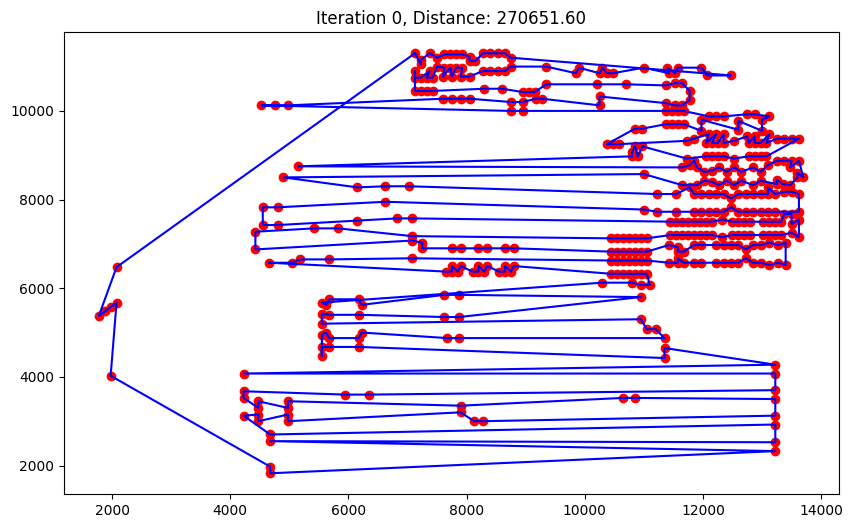

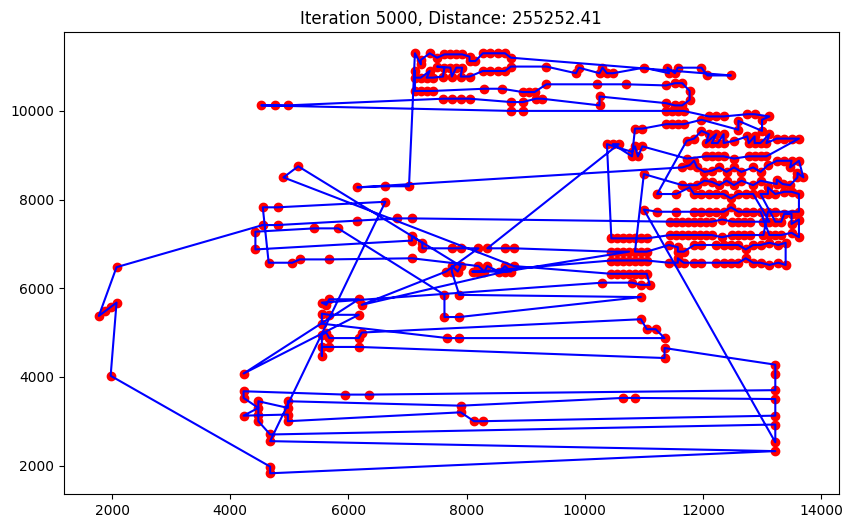

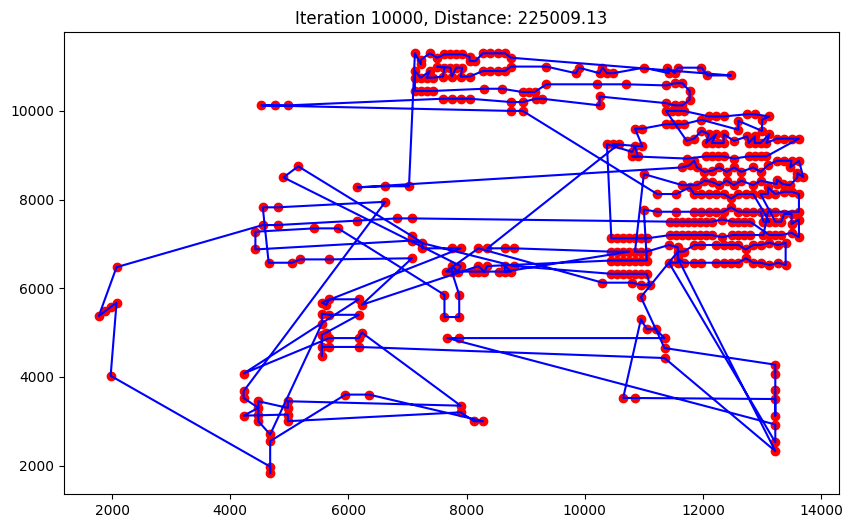

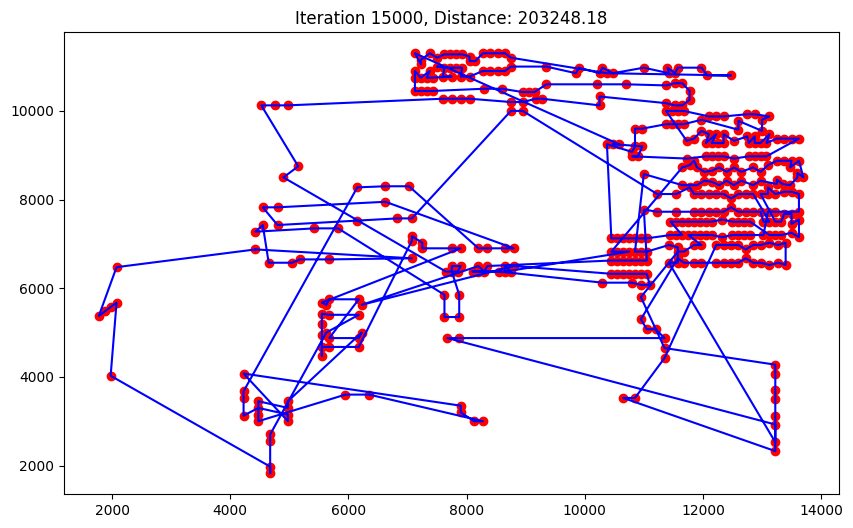

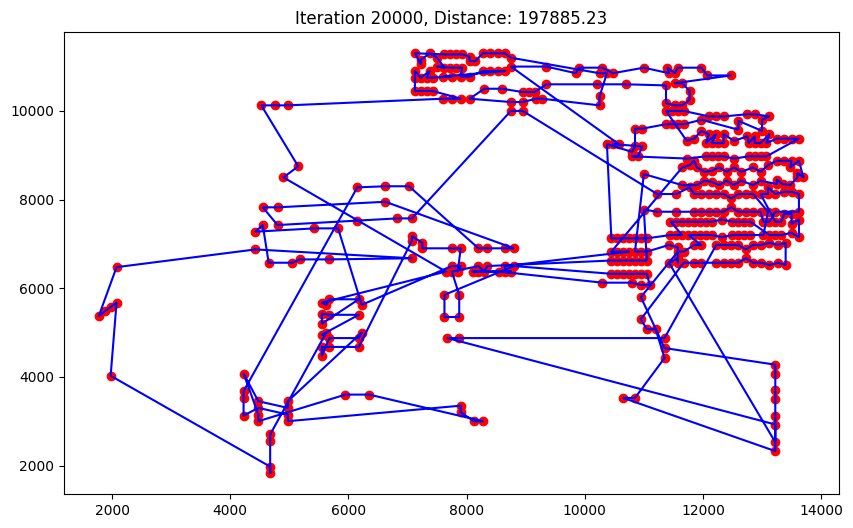

...

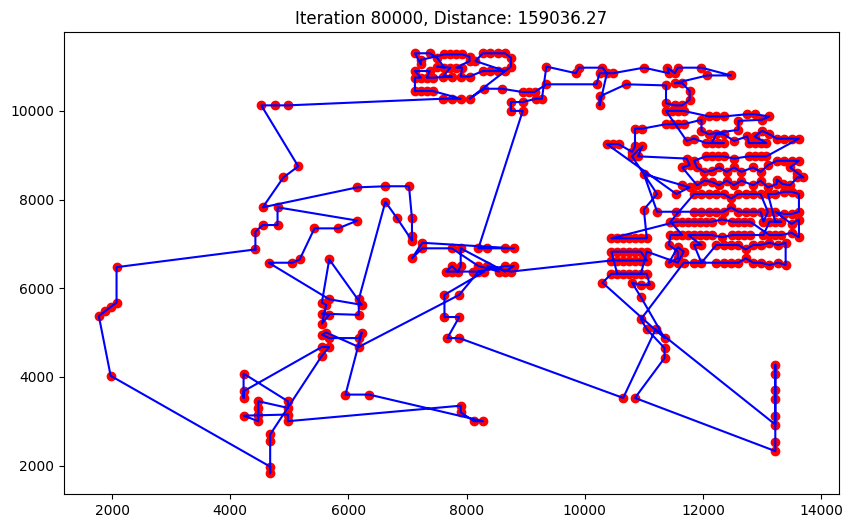

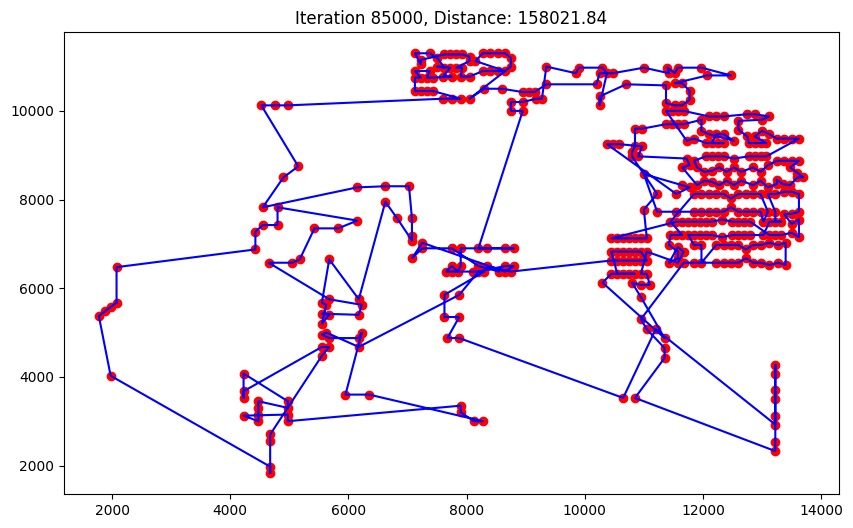

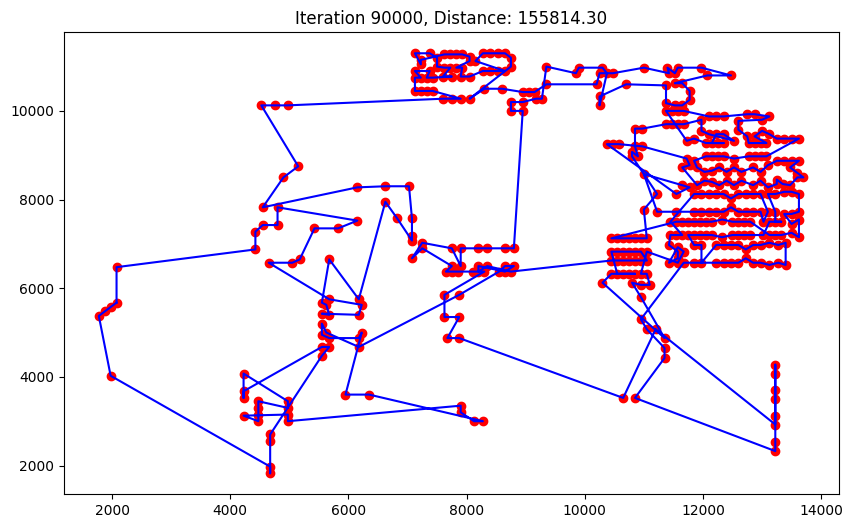

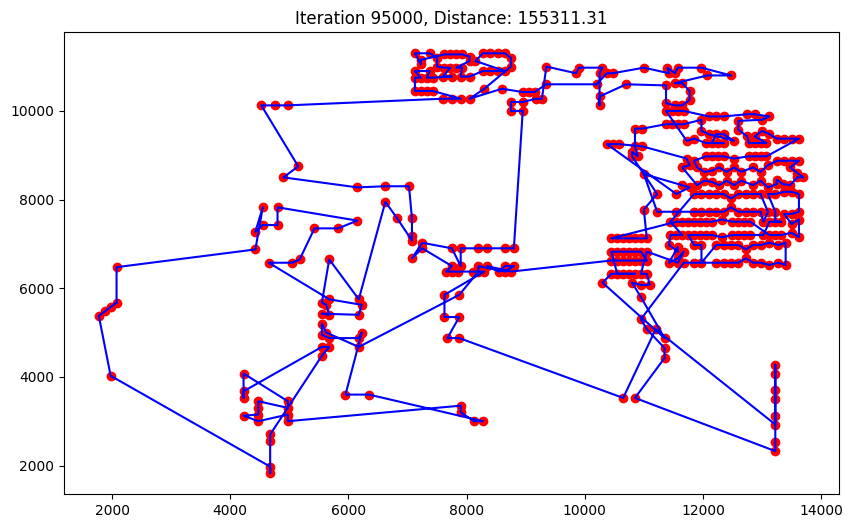

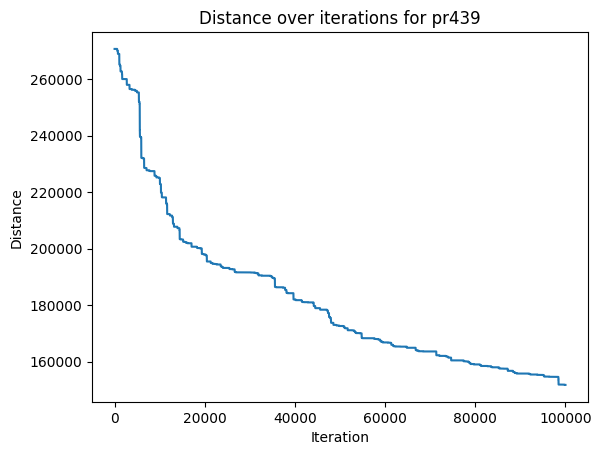

-----------------------------------------------------------------------
Best Route: [434, 435, 436, 437, 433, 432, 431, 429, 426, 395, 397, 396, 402, 408, 407, 412, 411, 410, 409, 424, 425, 423, 422, 421, 413, 420, 419, 418, 405, 406, 390, 391, 392, 394, 383, 393, 398, 376, 350, 351, 348, 355, 358, 356, 354, 353, 357, 338, 337, 336, 335, 334, 364, 365, 366, 367, 368, 377, 369, 359, 362, 363, 361, 360, 293, 294, 295, 296, 297, 298, 332, 333, 299, 330, 303, 329, 331, 301, 302, 300, 271, 270, 269, 232, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 210, 245, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 184, 183, 191, 190, 109, 110, 111, 143, 142, 150, 149, 182, 181, 180, 179, 178, 177, 176, 175, 174, 203, 173, 172, 171, 170, 169, 167, 168, 165, 166, 164, 163, 162, 161, 160, 159, 158, 157, 156, 155, 154, 153, 152, 151, 141, 140, 139, 138, 137, 136, 135, 134, 133, 132, 131, 130, 129, 127, 98, 124, 128, 126, 125, 123, 122, 100, 99, 97, 96, 95, 94, 93, 92, 91, 90, 89, 88, 87

In [ ]:
# @title Wykorzystanie algorytmu dla zestawu 'pr439'
coords = read_tsplib('/content/drive/MyDrive/Colab Notebooks/inteligencja obliczeniowa/pr439.tsp')
initial_temperature = 1000
cooling_rate = 0.995
num_iterations = 100000

best_tour, best_distance, distances = simulated_annealing(coords, initial_temperature, cooling_rate, num_iterations)

plt.plot(distances)
plt.title('Distance over iterations for pr439')
plt.xlabel('Iteration')
plt.ylabel('Distance')
plt.show()

print("-----------------------------------------------------------------------")
print("Best Route:", best_tour)
print("Best Distance:", best_distance)
print("-----------------------------------------------------------------------")
print("Optimal Solution for pr439 : 107217")

optimal_solution = 107217
difference = best_distance - optimal_solution
percentage_difference = (difference / optimal_solution) * 100

print(f"Our solution differs from the optimal solution by {percentage_difference:.2f}%")
print("-----------------------------------------------------------------------")



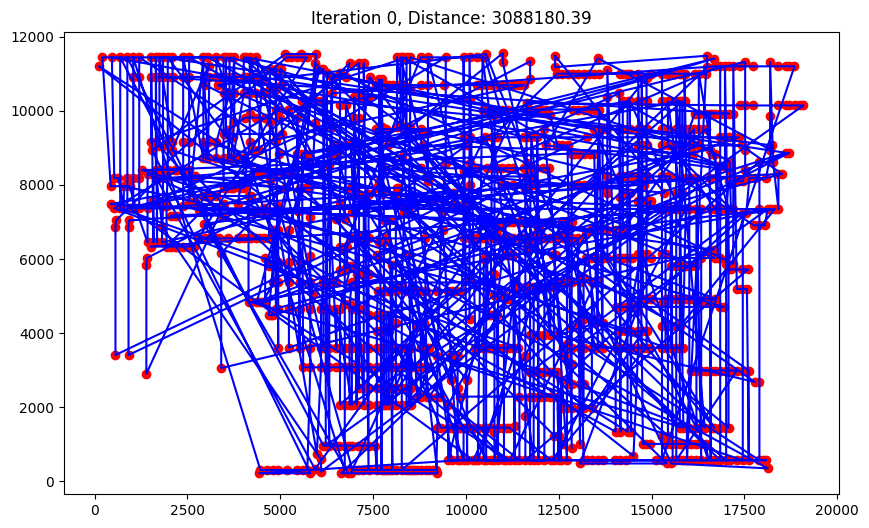

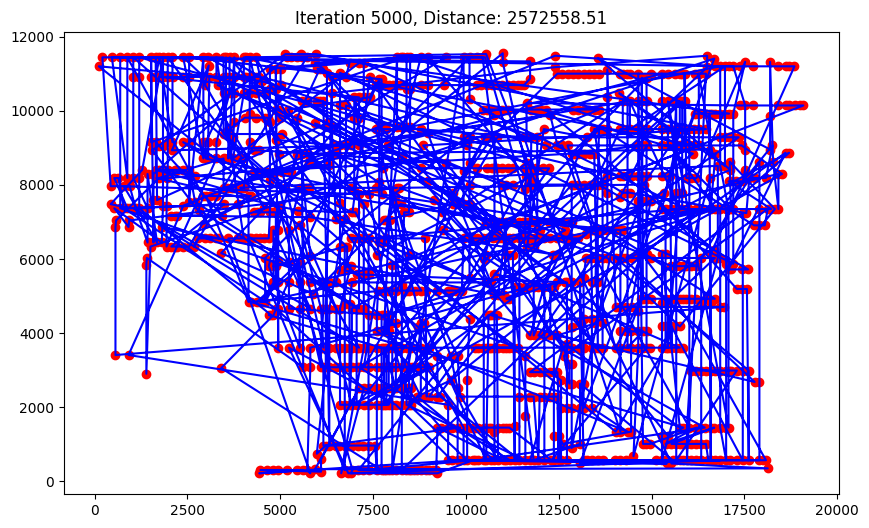

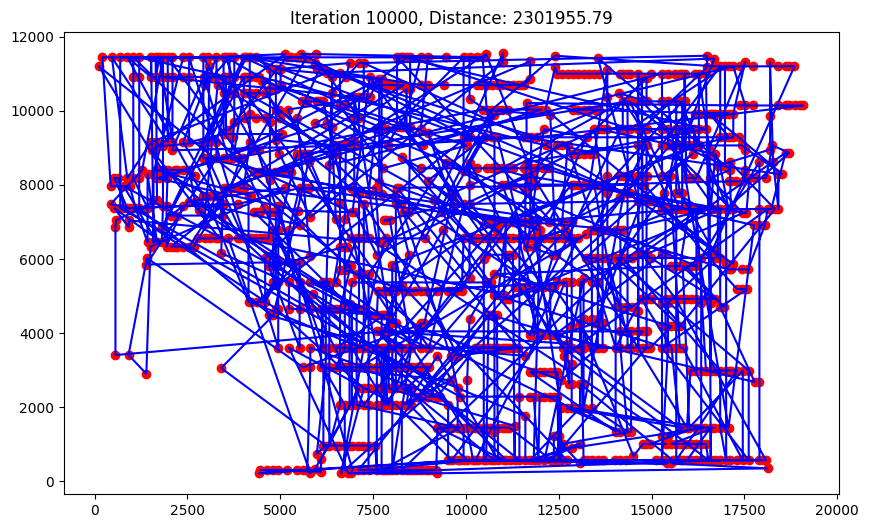

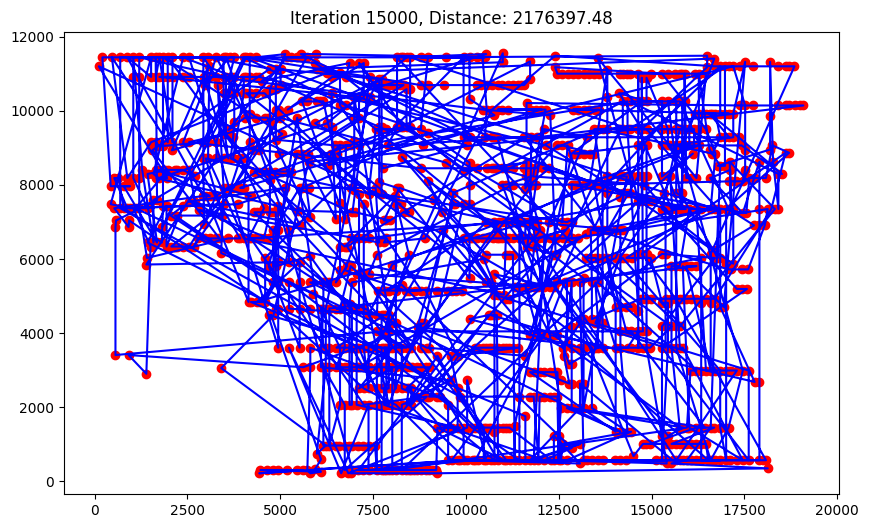

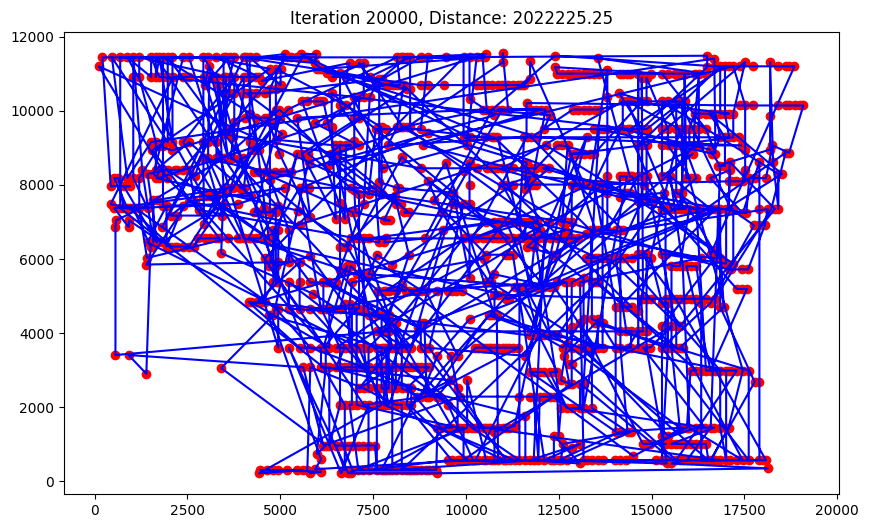

...

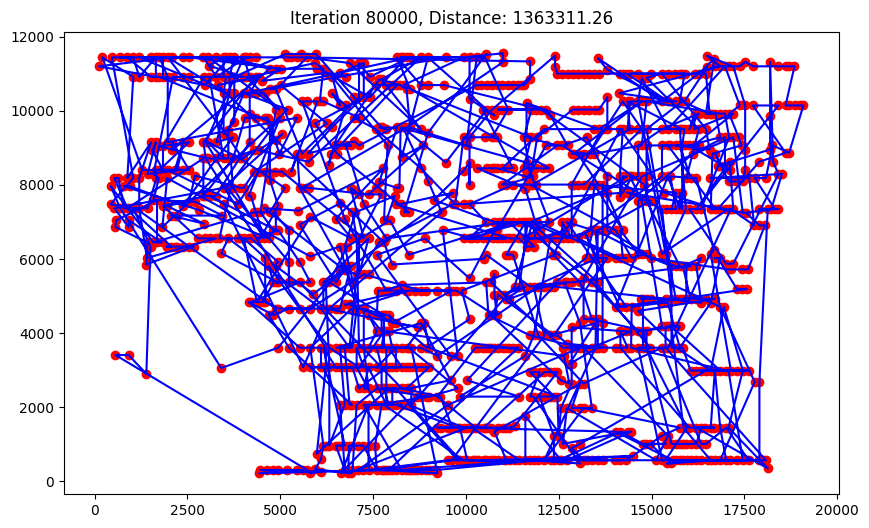

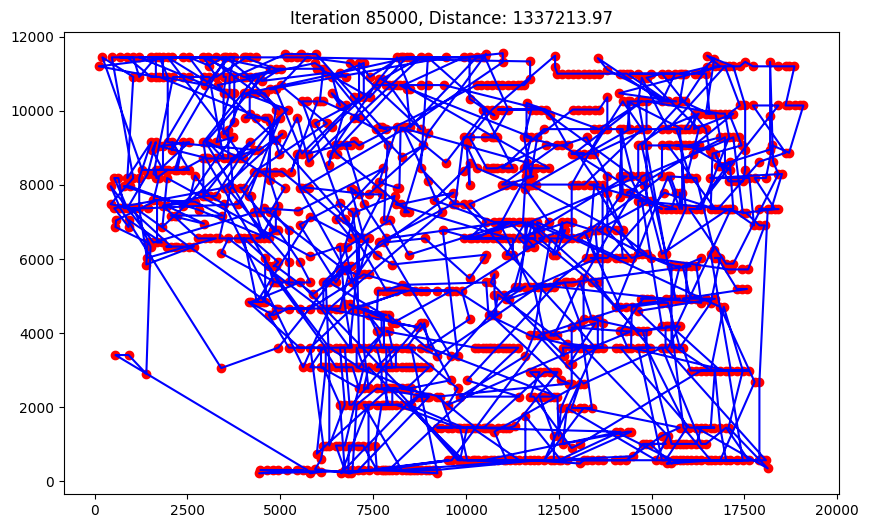

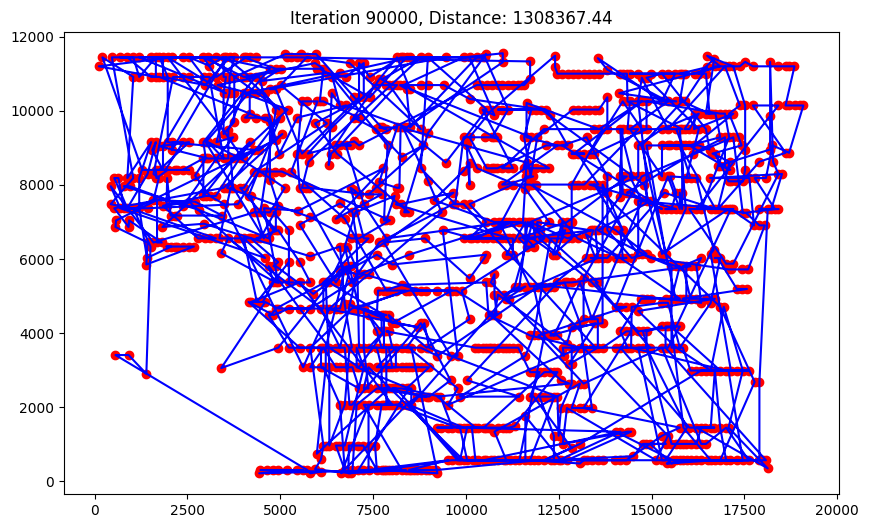

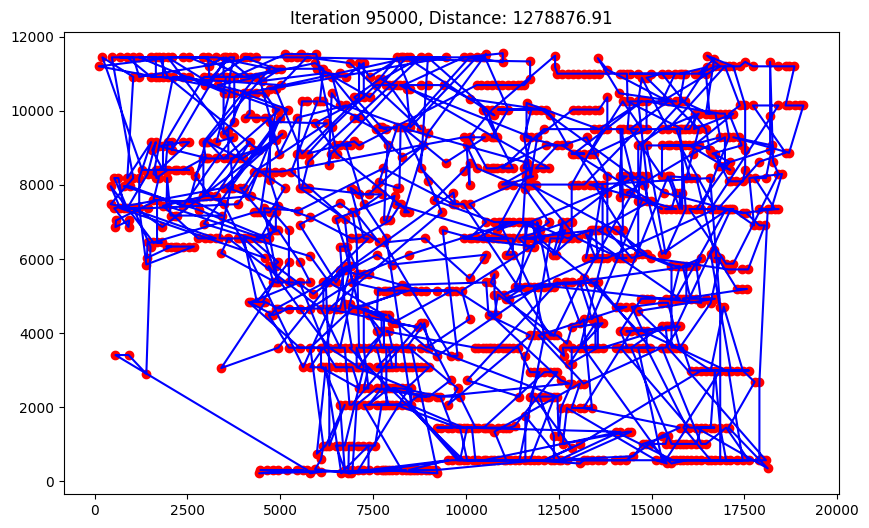

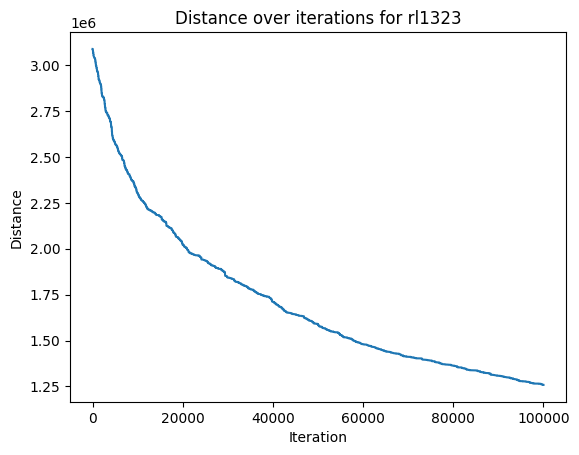

-----------------------------------------------------------------------
Best Route: [959, 960, 1033, 1060, 1166, 803, 1239, 63, 60, 529, 972, 973, 974, 975, 307, 839, 308, 964, 780, 248, 247, 246, 757, 695, 693, 1195, 993, 807, 742, 1257, 177, 889, 999, 891, 914, 903, 1220, 784, 783, 782, 605, 781, 249, 668, 1128, 981, 417, 1149, 1265, 1238, 1094, 459, 99, 297, 1246, 1150, 1151, 1152, 1153, 1073, 78, 1312, 79, 1049, 1050, 649, 301, 648, 302, 303, 562, 488, 487, 90, 92, 93, 95, 96, 460, 1193, 1194, 1286, 1308, 1179, 652, 577, 765, 1133, 848, 769, 943, 942, 23, 72, 437, 439, 440, 441, 368, 772, 1304, 341, 1181, 213, 166, 14, 1205, 282, 283, 145, 1087, 1169, 163, 1197, 1135, 1047, 281, 266, 1172, 536, 515, 827, 826, 342, 1062, 1061, 26, 883, 1171, 159, 138, 1182, 347, 831, 160, 30, 31, 1196, 1187, 550, 924, 925, 1130, 543, 541, 312, 311, 530, 310, 963, 1120, 871, 872, 221, 108, 1079, 560, 340, 309, 1119, 143, 64, 932, 165, 217, 218, 219, 544, 545, 314, 315, 250, 669, 892, 1213, 1212, 274,

In [ ]:
# @title Wykorzystanie algorytmu dla zestawu 'rl1323'
coords = read_tsplib('/content/drive/MyDrive/Colab Notebooks/inteligencja obliczeniowa/rl1323.tsp')
initial_temperature = 1000
cooling_rate = 0.995
num_iterations = 100000

best_tour, best_distance, distances = simulated_annealing(coords, initial_temperature, cooling_rate, num_iterations)

plt.plot(distances)
plt.title('Distance over iterations for rl1323')
plt.xlabel('Iteration')
plt.ylabel('Distance')
plt.show()

print("-----------------------------------------------------------------------")
print("Best Route:", best_tour)
print("Best Distance:", best_distance)
print("-----------------------------------------------------------------------")
print("Optimal Solution for rl1323 : 270199")

optimal_solution = 270199
difference = best_distance - optimal_solution
percentage_difference = (difference / optimal_solution) * 100

print(f"Our solution differs from the optimal solution by {percentage_difference:.2f}%")
print("-----------------------------------------------------------------------")

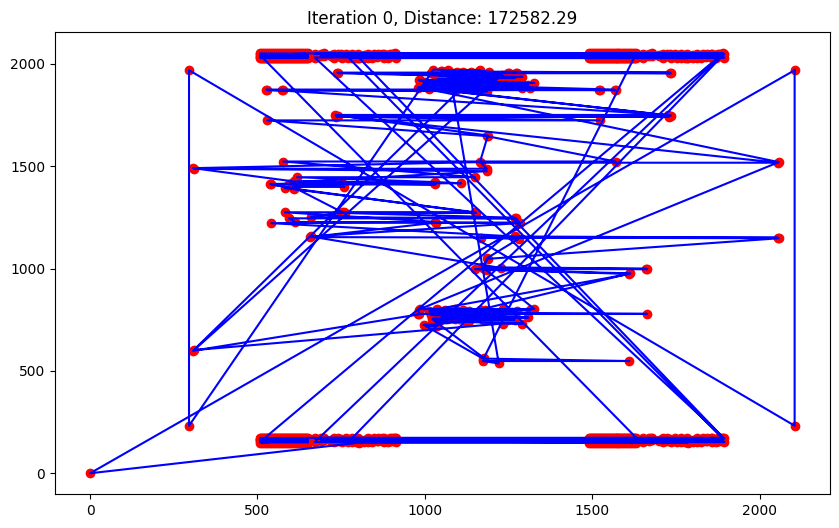

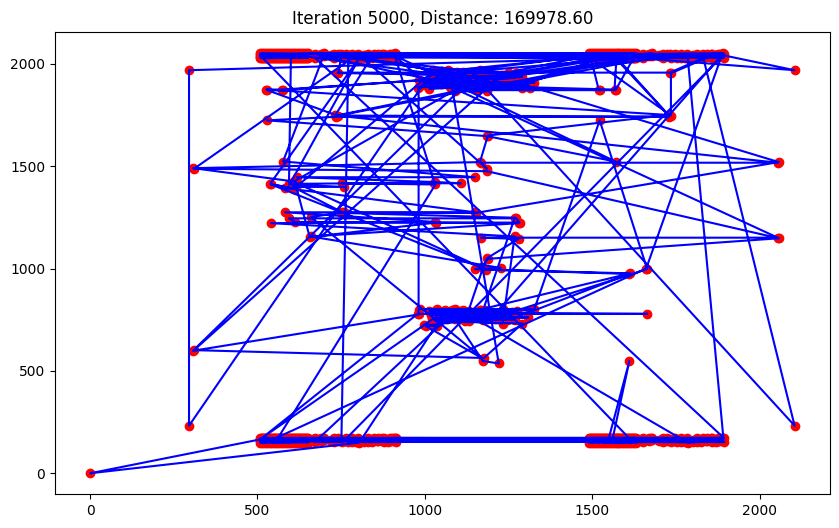

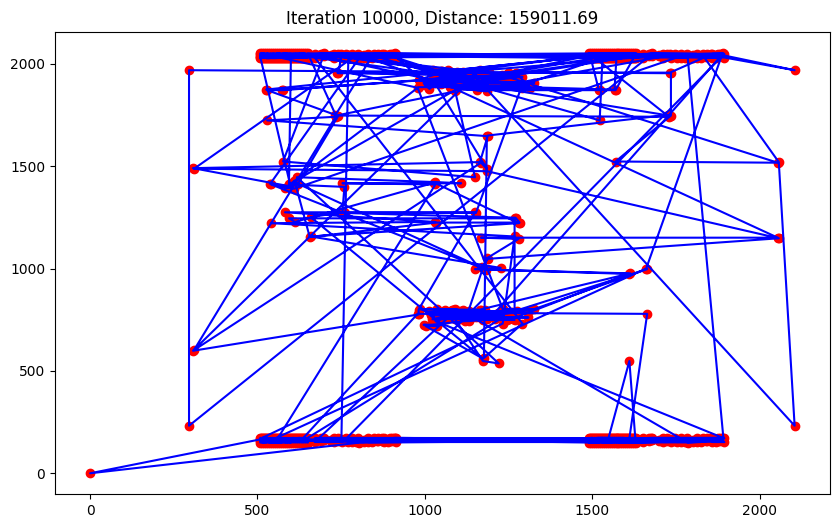

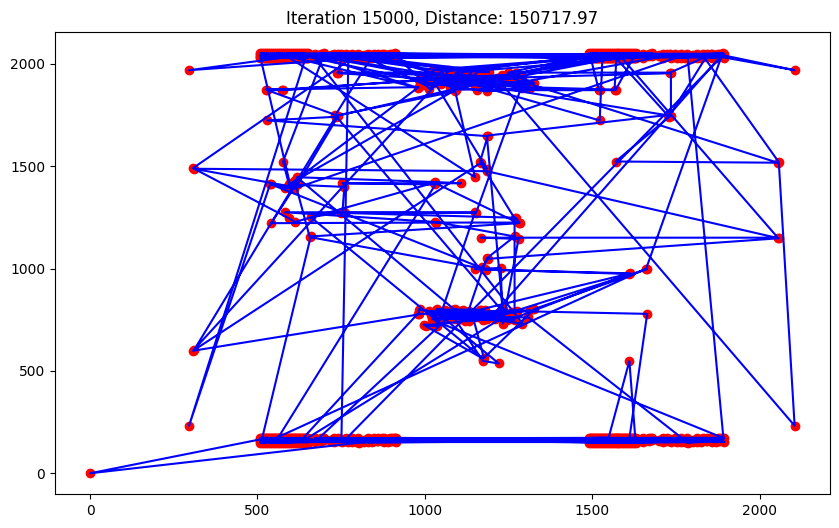

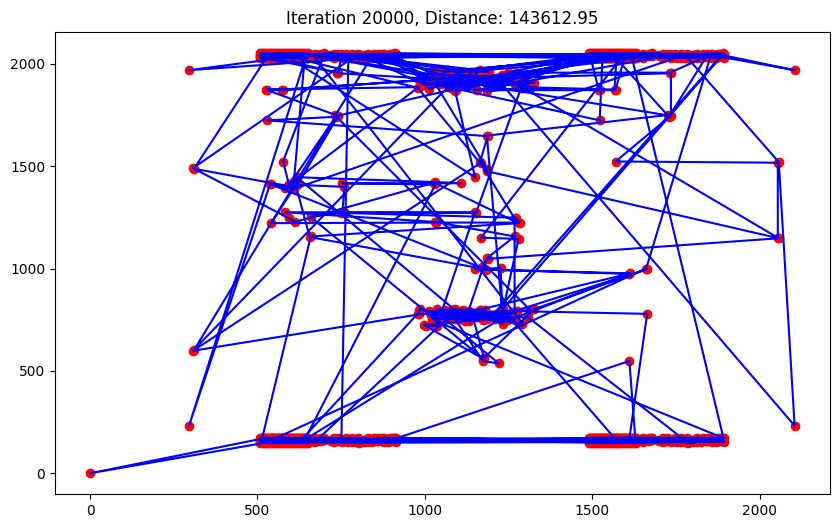

...

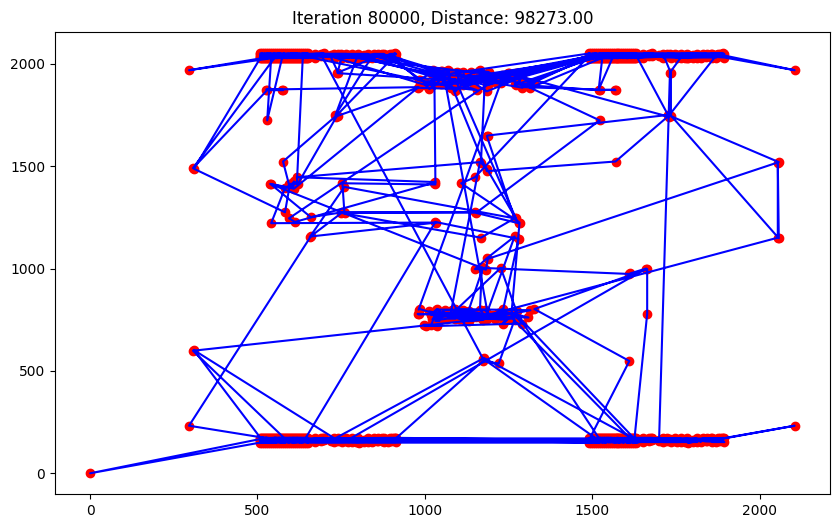

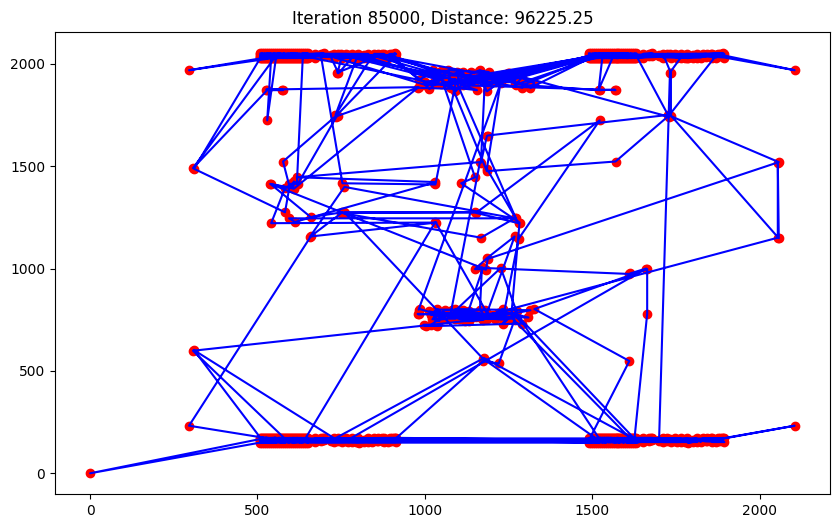

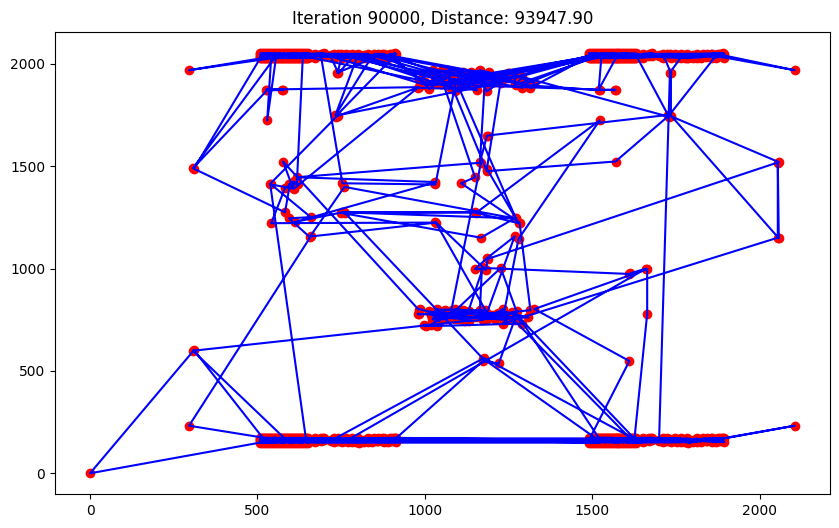

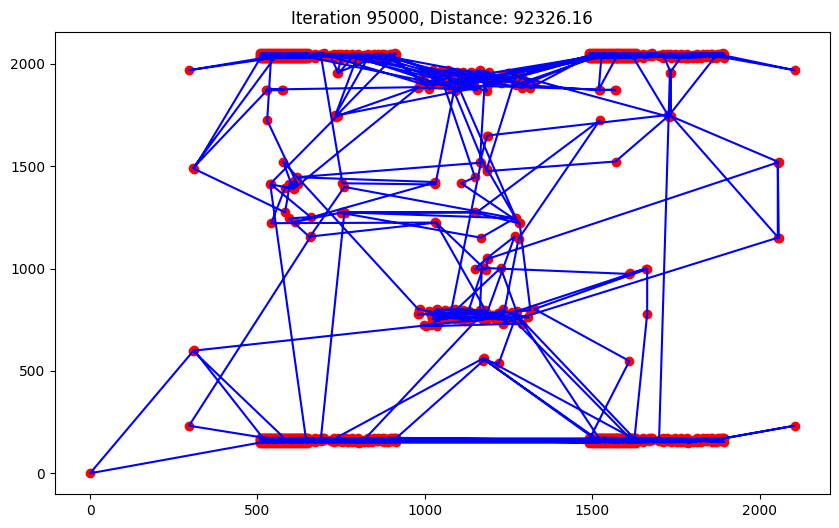

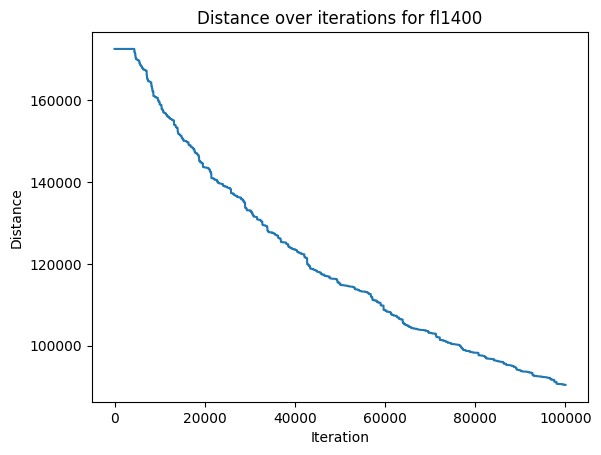

-----------------------------------------------------------------------
Best Route: [1054, 1018, 1078, 1151, 1152, 1126, 1099, 1013, 1145, 1041, 978, 1072, 1074, 1172, 1046, 1047, 983, 1095, 1096, 1167, 1119, 1033, 1161, 970, 1030, 1137, 1113, 1034, 1092, 1004, 1114, 1027, 1024, 1000, 1060, 1110, 1086, 1021, 250, 39, 37, 132, 133, 229, 24, 212, 231, 417, 514, 418, 393, 419, 467, 330, 353, 351, 462, 413, 346, 1203, 1303, 1375, 1302, 1312, 295, 1189, 1371, 1211, 1221, 0, 1311, 1223, 1222, 1301, 1300, 1179, 1180, 1181, 1224, 1225, 1226, 1383, 1227, 1327, 468, 334, 359, 358, 394, 395, 396, 422, 362, 473, 449, 341, 366, 303, 475, 420, 492, 421, 1323, 1188, 305, 451, 399, 448, 311, 501, 404, 310, 350, 384, 505, 433, 347, 314, 480, 374, 381, 349, 432, 373, 504, 316, 315, 431, 428, 370, 429, 430, 343, 453, 309, 376, 500, 498, 304, 495, 336, 361, 446, 296, 297, 445, 38, 116, 26, 32, 515, 416, 321, 508, 237, 452, 360, 300, 423, 335, 510, 511, 326, 486, 390, 389, 388, 354, 387, 327, 115, 144, 282

In [ ]:
# @title Wykorzystanie algorytmu dla zestawu 'fl1400'
coords = read_tsplib('/content/drive/MyDrive/Colab Notebooks/inteligencja obliczeniowa/fl1400.tsp')
initial_temperature = 1000
cooling_rate = 0.995
num_iterations = 100000

best_tour, best_distance, distances = simulated_annealing(coords, initial_temperature, cooling_rate, num_iterations)

plt.plot(distances)
plt.title('Distance over iterations for fl1400')
plt.xlabel('Iteration')
plt.ylabel('Distance')
plt.show()

print("-----------------------------------------------------------------------")
print("Best Route:", best_tour)
print("Best Distance:", best_distance)
print("-----------------------------------------------------------------------")
print("Optimal Solution for fl1400 : 20127")

optimal_solution = 20127
difference = best_distance - optimal_solution
percentage_difference = (difference / optimal_solution) * 100

print(f"Our solution differs from the optimal solution by {percentage_difference:.2f}%")
print("-----------------------------------------------------------------------")


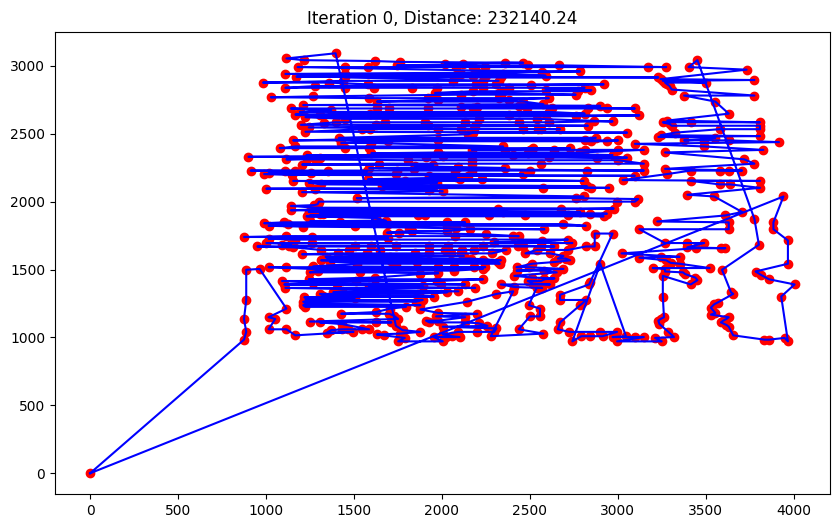

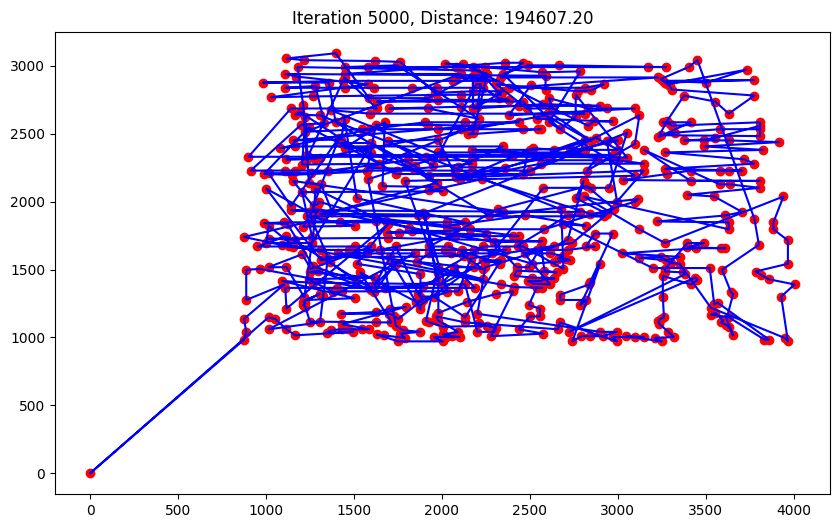

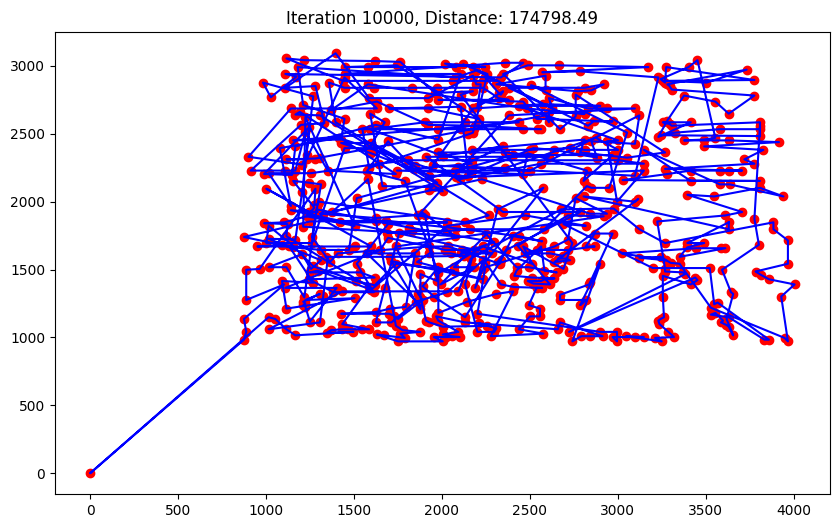

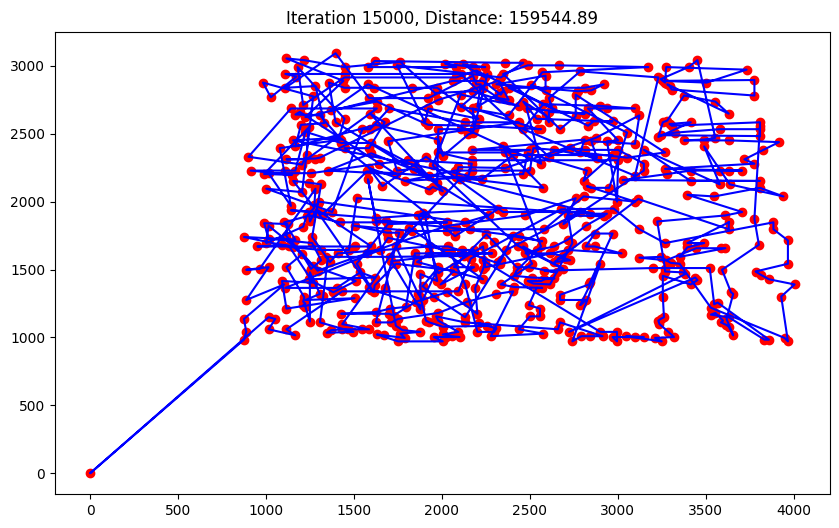

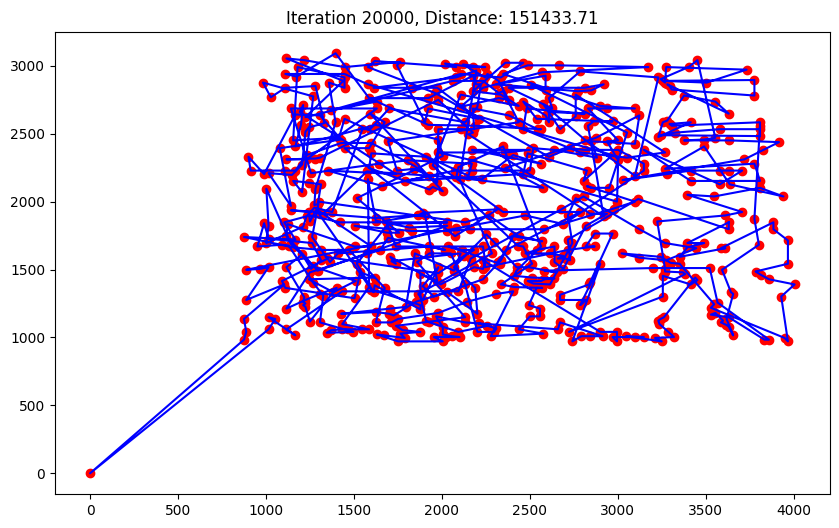

...

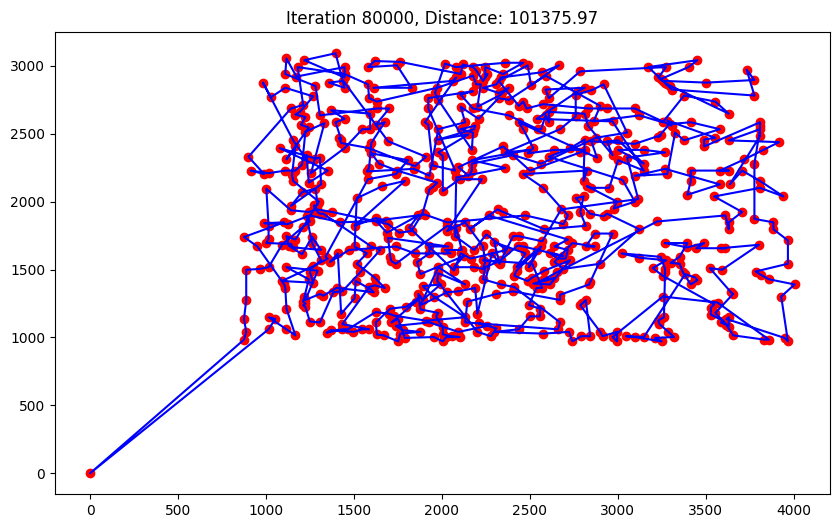

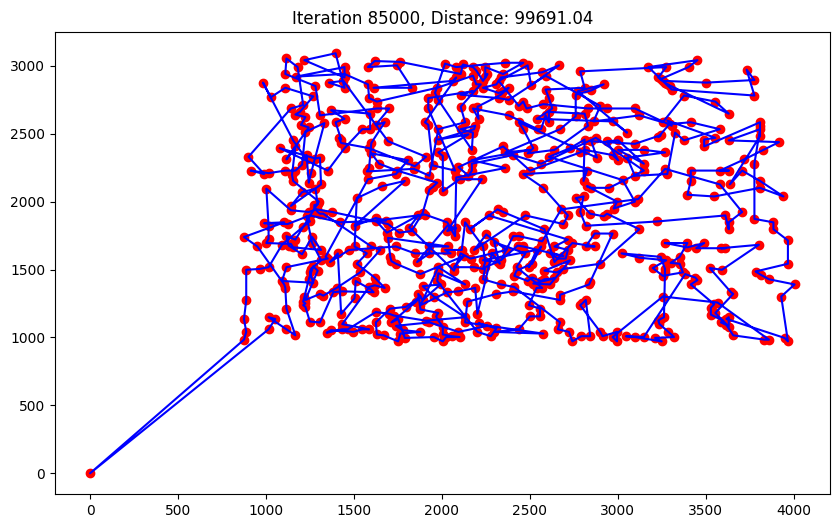

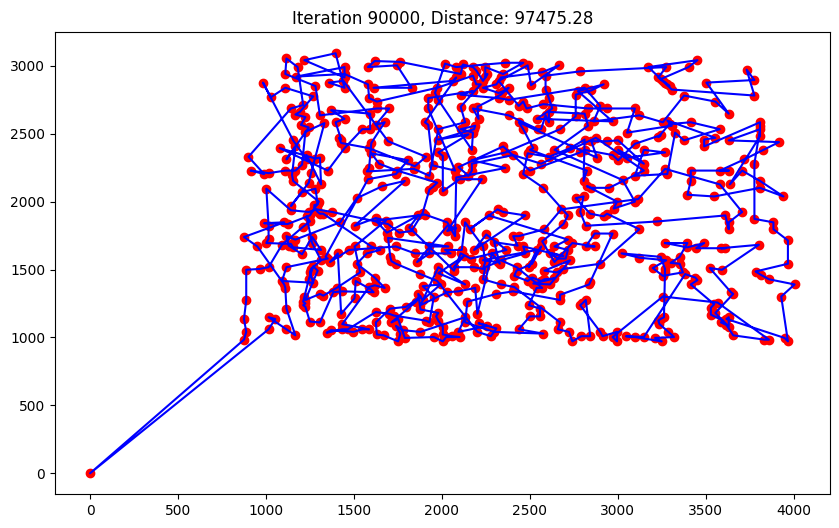

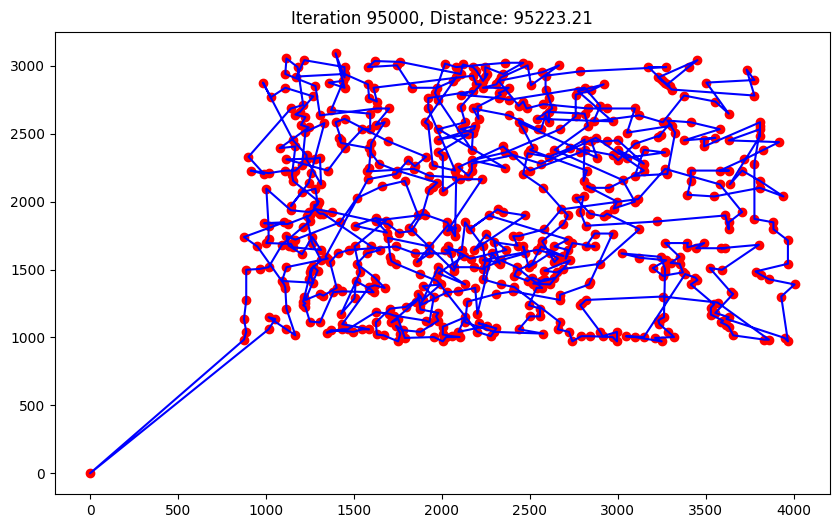

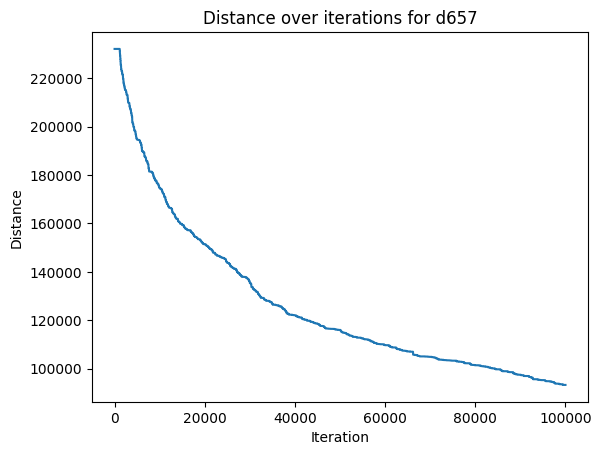

-----------------------------------------------------------------------
Best Route: [566, 565, 563, 564, 560, 562, 561, 627, 628, 552, 629, 630, 542, 541, 540, 539, 538, 537, 536, 535, 534, 531, 529, 532, 547, 546, 545, 544, 632, 633, 635, 638, 639, 640, 641, 642, 643, 644, 631, 634, 636, 637, 645, 646, 647, 648, 649, 650, 651, 652, 653, 654, 655, 626, 587, 603, 594, 593, 590, 588, 583, 584, 582, 578, 574, 573, 575, 656, 579, 585, 576, 599, 604, 609, 591, 596, 597, 595, 602, 608, 610, 605, 306, 356, 355, 354, 362, 352, 363, 359, 403, 417, 428, 392, 407, 394, 385, 384, 379, 374, 376, 357, 333, 351, 339, 328, 265, 295, 256, 272, 255, 243, 228, 250, 291, 244, 278, 281, 273, 258, 229, 581, 601, 606, 598, 600, 592, 279, 589, 266, 280, 257, 297, 296, 302, 282, 213, 212, 216, 200, 194, 201, 580, 246, 319, 343, 344, 329, 338, 315, 314, 313, 286, 283, 245, 222, 301, 285, 267, 274, 233, 211, 174, 160, 135, 499, 502, 504, 496, 124, 506, 503, 125, 498, 494, 491, 486, 490, 487, 488, 489, 485, 484, 

In [ ]:
# @title Wykorzystanie algorytmu dla zestawu 'd657'
coords = read_tsplib('/content/drive/MyDrive/Colab Notebooks/inteligencja obliczeniowa/d657.tsp')
initial_temperature = 1000
cooling_rate = 0.995
num_iterations = 100000

best_tour, best_distance, distances = simulated_annealing(coords, initial_temperature, cooling_rate, num_iterations)

plt.plot(distances)
plt.title('Distance over iterations for d657')
plt.xlabel('Iteration')
plt.ylabel('Distance')
plt.show()

print("-----------------------------------------------------------------------")
print("Best Route:", best_tour)
print("Best Distance:", best_distance)
print("-----------------------------------------------------------------------")
print("Optimal Solution for d657 : 48912")

optimal_solution = 48912
difference = best_distance - optimal_solution
percentage_difference = (difference / optimal_solution) * 100

print(f"Our solution differs from the optimal solution by {percentage_difference:.2f}%")
print("-----------------------------------------------------------------------")


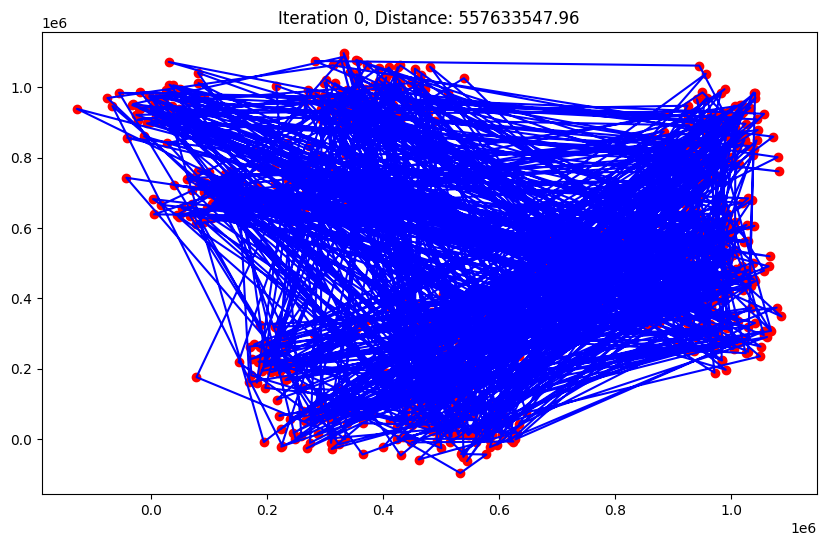

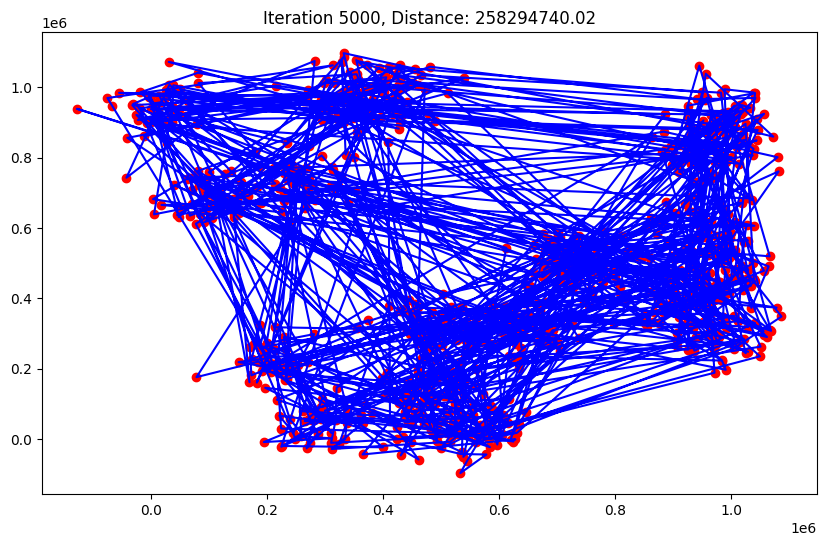

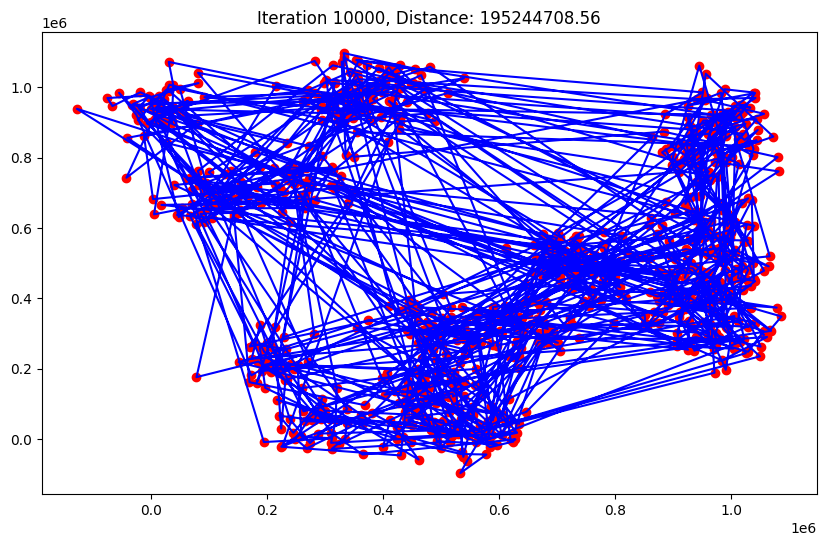

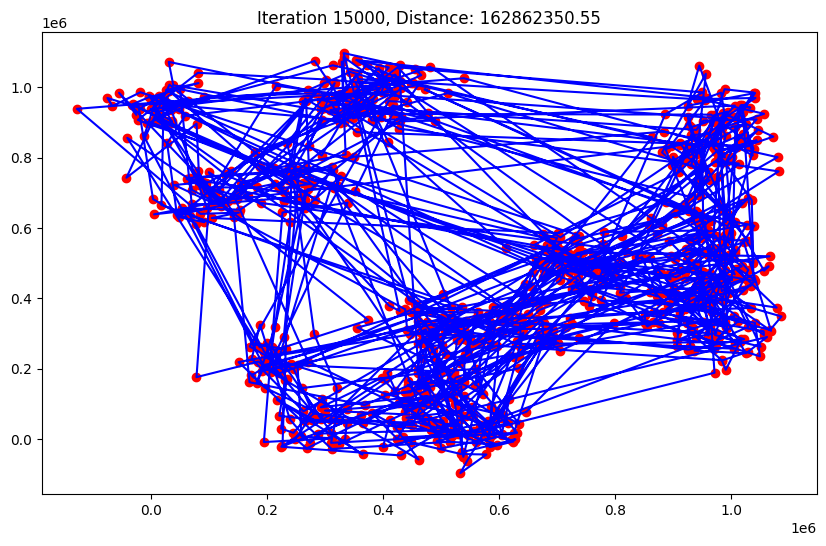

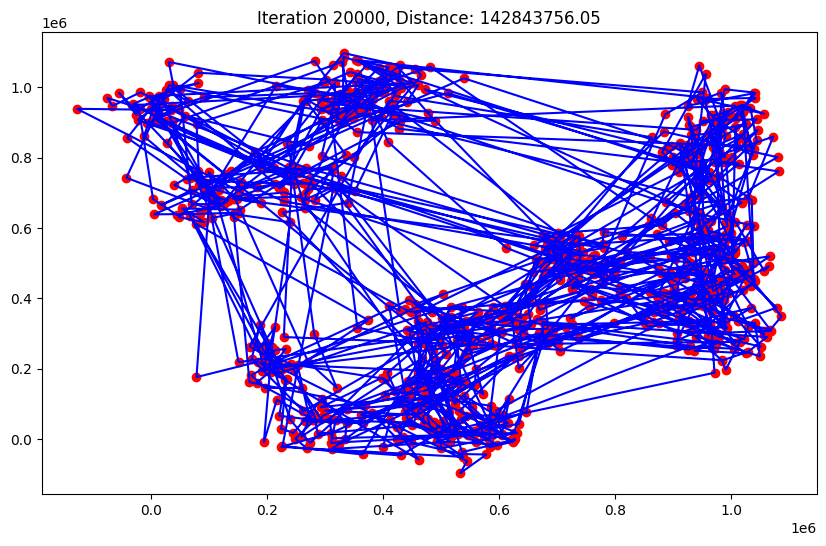

...

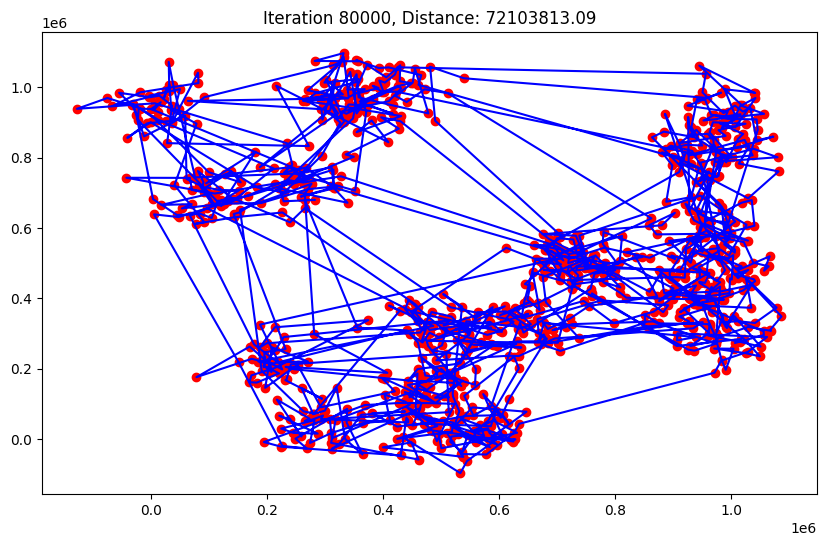

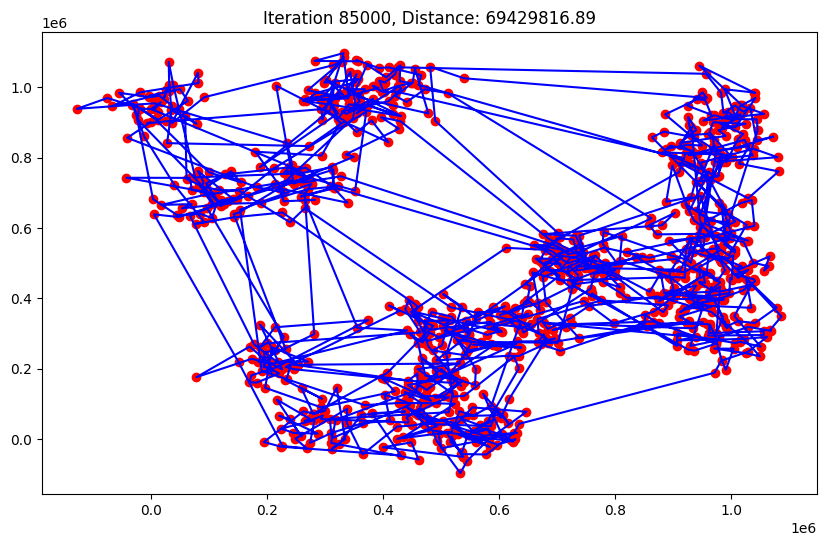

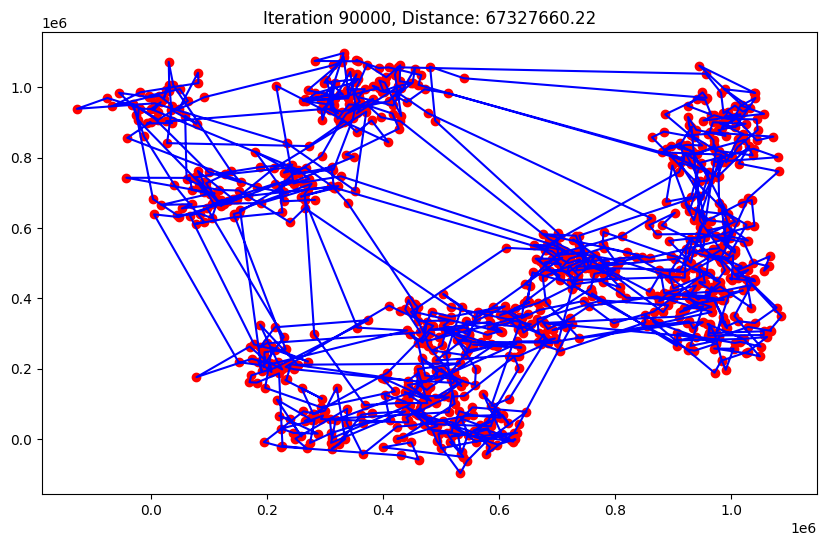

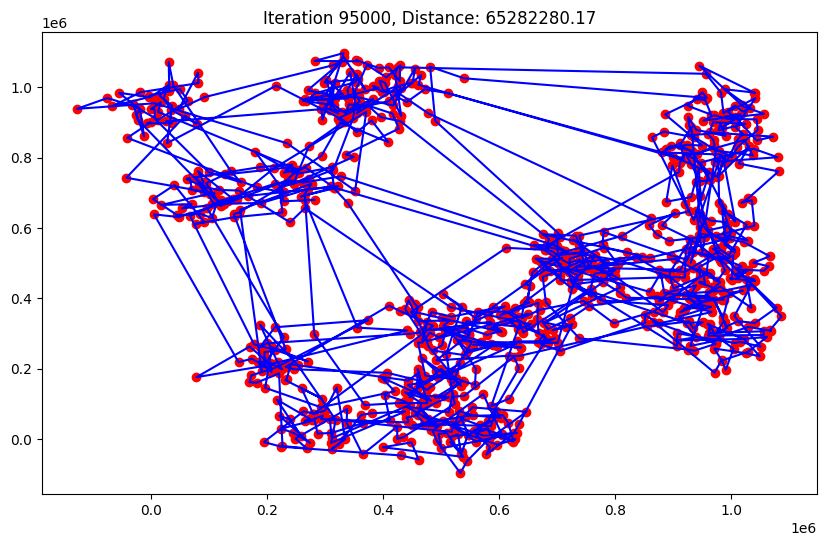

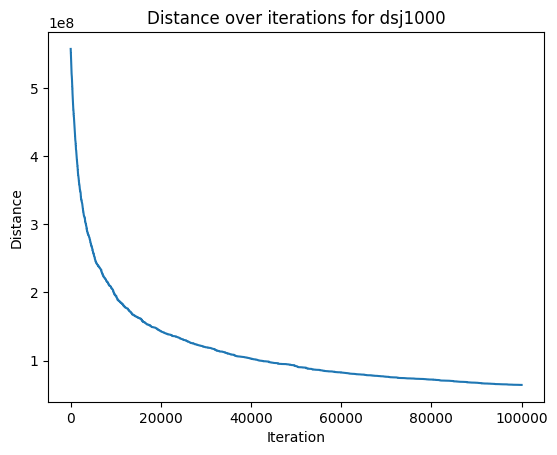

-----------------------------------------------------------------------
Best Route: [780, 543, 623, 20, 299, 727, 191, 863, 39, 278, 875, 631, 228, 970, 323, 440, 670, 430, 733, 344, 93, 663, 657, 853, 359, 446, 478, 48, 538, 991, 324, 556, 762, 776, 509, 504, 372, 179, 895, 75, 689, 121, 311, 465, 634, 339, 43, 309, 979, 693, 559, 995, 70, 994, 676, 989, 113, 225, 973, 820, 31, 437, 929, 951, 829, 609, 511, 796, 658, 291, 259, 279, 385, 140, 650, 151, 640, 154, 493, 797, 554, 268, 471, 114, 867, 843, 907, 787, 884, 924, 492, 645, 591, 856, 746, 599, 320, 239, 899, 192, 248, 330, 367, 138, 969, 651, 835, 831, 747, 198, 993, 199, 363, 17, 703, 566, 510, 635, 641, 498, 810, 405, 396, 280, 27, 569, 375, 839, 981, 905, 485, 534, 187, 47, 406, 331, 772, 432, 168, 987, 447, 454, 737, 97, 584, 532, 985, 29, 936, 319, 149, 0, 421, 870, 665, 799, 144, 952, 600, 247, 42, 531, 581, 565, 336, 61, 348, 526, 695, 196, 301, 739, 990, 119, 63, 661, 891, 620, 15, 44, 864, 930, 269, 846, 862, 898, 281, 

In [ ]:
# @title Wykorzystanie algorytmu dla zestawu 'dsj1000'
coords = read_tsplib('/content/drive/MyDrive/Colab Notebooks/inteligencja obliczeniowa/dsj1000.tsp')
initial_temperature = 1000
cooling_rate = 0.995
num_iterations = 100000

best_tour, best_distance, distances = simulated_annealing(coords, initial_temperature, cooling_rate, num_iterations)

plt.plot(distances)
plt.title('Distance over iterations for dsj1000')
plt.xlabel('Iteration')
plt.ylabel('Distance')
plt.show()

print("-----------------------------------------------------------------------")
print("Best Route:", best_tour)
print("Best Distance:", best_distance)
print("-----------------------------------------------------------------------")
print("Optimal Solution for dsj1000 : 18659688")

optimal_solution = 18659688
difference = best_distance - optimal_solution
percentage_difference = (difference / optimal_solution) * 100

print(f"Our solution differs from the optimal solution by {percentage_difference:.2f}%")
print("-----------------------------------------------------------------------")


### Wniosek
W przypadku 5 przedstawionych powyżej zestawów, napisany algorytm dobrze radził sobie z rozwiązaniem problemów. Mimo, iż odbiega od zoptymalizowanych rozwiązań na wykresie można zauważyć, że gdyby zwiększyć liczbę iteracji możnaby osiągnąć wyniki bardziej zbliżone do optymnalnych. Algorytm nie był uruchamiany dla większej ilości iteracji, ze względu na ograniczenia sprzętowe oraz czasowe. Sam cel pracy nie polegał na znalezieniu idealnego rozwiązania, lecz na zrozumieniu działania algorytmu.